# Problem Statement:
## This is a classification project, since the variable to predict is binary (bankruptcy or non-bankruptcy). The goal here is to model the probability that a business goes bankruptfrom different features.

# 1.Import necessary laibaries

In [3]:
# importing pandas library for data handling and manipulation
import pandas as pd
#importing numpy for scientific calculation 
import numpy as np
#importing pyplot module from matplotlib for data visualization including seaborn as sns 
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

#for encoding categorical variables into numerical values
from sklearn.preprocessing import LabelEncoder

#importing create report
from dataprep.eda import create_report

# for identifying data points that are significantly different from the rest of the data
from sklearn.ensemble import IsolationForest

# for model building
from sklearn.ensemble import VotingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import MultinomialNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier,ExtraTreesClassifier,AdaBoostClassifier,BaggingClassifier,GradientBoostingClassifier

#calculate the whole PPS matrix
import ppscore as pps

### Import data

In [4]:
bankrupt = pd.read_csv("bankruptcy-prevention.csv", sep=';')

In [5]:
bankrupt

,industrial_risk,management_risk,financial_flexibility,credibility,competitiveness,operating_risk,class
0,0.5,1.0,0.0,0.0,0.0,0.5,bankruptcy
1,0.0,1.0,0.0,0.0,0.0,1.0,bankruptcy
2,1.0,0.0,0.0,0.0,0.0,1.0,bankruptcy
3,0.5,0.0,0.0,0.5,0.0,1.0,bankruptcy
4,1.0,1.0,0.0,0.0,0.0,1.0,bankruptcy
...,...,...,...,...,...,...,...
245,0.0,1.0,1.0,1.0,1.0,1.0,non-bankruptcy
246,1.0,1.0,0.5,1.0,1.0,0.0,non-bankruptcy
247,0.0,1.0,1.0,0.5,0.5,0.0,non-bankruptcy
248,1.0,0.0,0.5,1.0,0.5,0.0,non-bankruptcy


#### The data set includes the following variables :


### We need to have LOW (industrial risk , management risk , operating risk) and HIGH (financial flexibility , credibility , competitiveness) in ordere to avoid Bankruptcy

#### Step1: Describe the Dataset

In [6]:
bankrupt.head()

,industrial_risk,management_risk,financial_flexibility,credibility,competitiveness,operating_risk,class
0,0.5,1.0,0.0,0.0,0.0,0.5,bankruptcy
1,0.0,1.0,0.0,0.0,0.0,1.0,bankruptcy
2,1.0,0.0,0.0,0.0,0.0,1.0,bankruptcy
3,0.5,0.0,0.0,0.5,0.0,1.0,bankruptcy
4,1.0,1.0,0.0,0.0,0.0,1.0,bankruptcy


In [7]:
bankrupt.tail()

,industrial_risk,management_risk,financial_flexibility,credibility,competitiveness,operating_risk,class
245,0.0,1.0,1.0,1.0,1.0,1.0,non-bankruptcy
246,1.0,1.0,0.5,1.0,1.0,0.0,non-bankruptcy
247,0.0,1.0,1.0,0.5,0.5,0.0,non-bankruptcy
248,1.0,0.0,0.5,1.0,0.5,0.0,non-bankruptcy
249,1.0,0.0,0.5,0.5,1.0,1.0,non-bankruptcy


In [8]:
# Unique value for each columns 
bankrupt.nunique()

industrial_risk           3
 management_risk          3
 financial_flexibility    3
 credibility              3
 competitiveness          3
 operating_risk           3
 class                    2
dtype: int64

In [9]:
# Shape of Data
bankrupt.shape

(250, 7)

In [10]:
#Types of Data 
bankrupt.dtypes

industrial_risk           float64
 management_risk          float64
 financial_flexibility    float64
 credibility              float64
 competitiveness          float64
 operating_risk           float64
 class                     object
dtype: object

In [11]:
# Describe the data
bankrupt.describe()

,industrial_risk,management_risk,financial_flexibility,credibility,competitiveness,operating_risk
count,250.000000,250.000000,250.000000,250.000000,250.000000,250.000000
mean,0.518000,0.614000,0.376000,0.470000,0.476000,0.570000
std,0.411526,0.410705,0.401583,0.415682,0.440682,0.434575
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.500000,0.000000,0.000000,0.000000,0.000000
50%,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
75%,1.000000,1.000000,0.500000,1.000000,1.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [12]:
# Check missing value
bankrupt.isnull().sum()

industrial_risk           0
 management_risk          0
 financial_flexibility    0
 credibility              0
 competitiveness          0
 operating_risk           0
 class                    0
dtype: int64

In [13]:
# information of Data
bankrupt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 250 entries, 0 to 249
Data columns (total 7 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   industrial_risk         250 non-null    float64
 1    management_risk        250 non-null    float64
 2    financial_flexibility  250 non-null    float64
 3    credibility            250 non-null    float64
 4    competitiveness        250 non-null    float64
 5    operating_risk         250 non-null    float64
 6    class                  250 non-null    object 
dtypes: float64(6), object(1)
memory usage: 13.8+ KB


#### Step2: Cleaning the Data

In [14]:
# Check the Duplicates
bankrupt.duplicated()

0      False
1      False
2      False
3      False
4      False
       ...  
245     True
246     True
247     True
248     True
249     True
Length: 250, dtype: bool

In [15]:
bankrupt[bankrupt.duplicated()].shape

(147, 7)

In [16]:
# Drop Duplicates
bank1 = bankrupt.drop_duplicates()

In [17]:
bank1

,industrial_risk,management_risk,financial_flexibility,credibility,competitiveness,operating_risk,class
0,0.5,1.0,0.0,0.0,0.0,0.5,bankruptcy
1,0.0,1.0,0.0,0.0,0.0,1.0,bankruptcy
2,1.0,0.0,0.0,0.0,0.0,1.0,bankruptcy
3,0.5,0.0,0.0,0.5,0.0,1.0,bankruptcy
4,1.0,1.0,0.0,0.0,0.0,1.0,bankruptcy
...,...,...,...,...,...,...,...
185,0.0,0.5,0.0,0.5,1.0,0.5,non-bankruptcy
187,0.0,0.5,0.5,0.5,1.0,0.5,non-bankruptcy
190,0.0,0.5,0.5,0.0,1.0,0.0,non-bankruptcy
192,0.5,1.0,0.0,0.0,1.0,0.0,non-bankruptcy


### Using Label Encoder at a categorical column to get binary value as its a classification project

In [18]:
from sklearn.preprocessing import LabelEncoder
labelencoder = LabelEncoder()
bank1.iloc[:, -1] = labelencoder.fit_transform(bank1.iloc[:,-1])

In [19]:
bank1

,industrial_risk,management_risk,financial_flexibility,credibility,competitiveness,operating_risk,class
0,0.5,1.0,0.0,0.0,0.0,0.5,0
1,0.0,1.0,0.0,0.0,0.0,1.0,0
2,1.0,0.0,0.0,0.0,0.0,1.0,0
3,0.5,0.0,0.0,0.5,0.0,1.0,0
4,1.0,1.0,0.0,0.0,0.0,1.0,0
...,...,...,...,...,...,...,...
185,0.0,0.5,0.0,0.5,1.0,0.5,1
187,0.0,0.5,0.5,0.5,1.0,0.5,1
190,0.0,0.5,0.5,0.0,1.0,0.0,1
192,0.5,1.0,0.0,0.0,1.0,0.0,1


##### Here we are changing the target variable to bankruptcy = 0,non-bankruptcy = 1

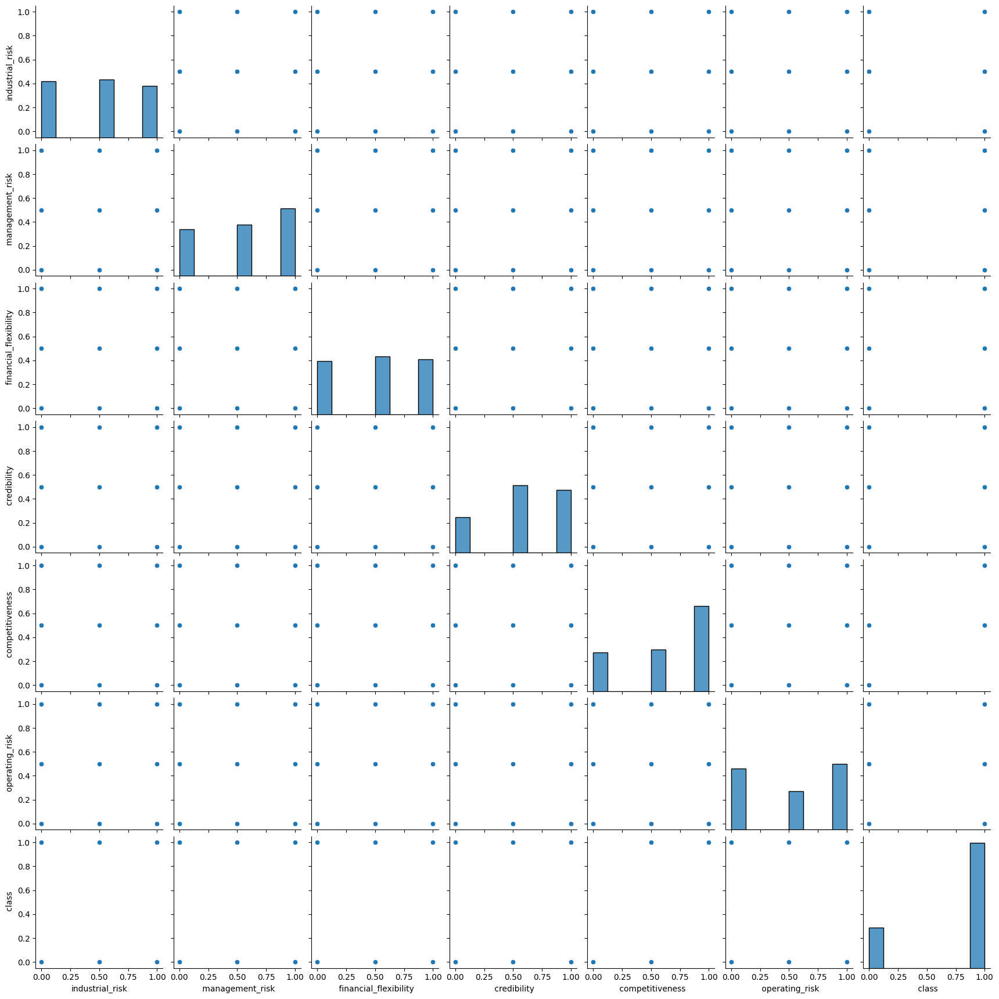

In [20]:
# Create the default pairplot
sns.pairplot(bank1)

## EDA from dataprep

In [21]:
!pip install dataprep

In [22]:
#importing create report
from dataprep.eda import create_report

  0%|                                                                                          | 0/705 [00:00<…

DataPrep Report
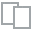
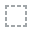
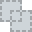
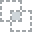
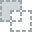
...
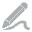
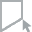
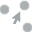
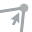
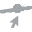

In [23]:
#creating automatic EDA using datapre
create_report(bank1)

## Outlier Detection  

#### Our algorithm can suffer a lot we don't remove the outliers and to avoid this problem we will drop the values .

In [24]:
# training the model
from sklearn.ensemble import IsolationForest
clf = IsolationForest(random_state=10,contamination=.01)
clf.fit(bank1)
y_pred_outliers = clf.predict(bank1)
y_pred_outliers

array([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1, -1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1, -1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1])

In [25]:
bank1['scores']=clf.decision_function(bank1)
bank1['anomaly']=clf.predict(bank1.iloc[:,0:7])
bank1

,industrial_risk,management_risk,financial_flexibility,credibility,competitiveness,operating_risk,class,scores,anomaly
0,0.5,1.0,0.0,0.0,0.0,0.5,0,0.086435,1
1,0.0,1.0,0.0,0.0,0.0,1.0,0,0.055785,1
2,1.0,0.0,0.0,0.0,0.0,1.0,0,0.029076,1
3,0.5,0.0,0.0,0.5,0.0,1.0,0,0.007516,1
4,1.0,1.0,0.0,0.0,0.0,1.0,0,0.105067,1
...,...,...,...,...,...,...,...,...,...
185,0.0,0.5,0.0,0.5,1.0,0.5,1,0.074722,1
187,0.0,0.5,0.5,0.5,1.0,0.5,1,0.113263,1
190,0.0,0.5,0.5,0.0,1.0,0.0,1,0.043893,1
192,0.5,1.0,0.0,0.0,1.0,0.0,1,0.032620,1


In [26]:
#print the anomaly
bank1[bank1['anomaly']==-1]

,industrial_risk,management_risk,financial_flexibility,credibility,competitiveness,operating_risk,class,scores,anomaly
10,1.0,1.0,0.5,0.0,0.0,1.0,0,-0.000111,-1
72,1.0,0.5,1.0,0.5,0.0,0.0,0,-0.037067,-1


## These are the outliers. Now we will drop them and reset the index

In [27]:
bank1 = bank1.drop(bank1.index[[10, 72]], axis=0)
bank1.reset_index(drop=True,inplace = True)
bank1

,industrial_risk,management_risk,financial_flexibility,credibility,competitiveness,operating_risk,class,scores,anomaly
0,0.5,1.0,0.0,0.0,0.0,0.5,0,0.086435,1
1,0.0,1.0,0.0,0.0,0.0,1.0,0,0.055785,1
2,1.0,0.0,0.0,0.0,0.0,1.0,0,0.029076,1
3,0.5,0.0,0.0,0.5,0.0,1.0,0,0.007516,1
4,1.0,1.0,0.0,0.0,0.0,1.0,0,0.105067,1
...,...,...,...,...,...,...,...,...,...
96,0.0,0.5,0.0,0.5,1.0,0.5,1,0.074722,1
97,0.0,0.5,0.5,0.5,1.0,0.5,1,0.113263,1
98,0.0,0.5,0.5,0.0,1.0,0.0,1,0.043893,1
99,0.5,1.0,0.0,0.0,1.0,0.0,1,0.032620,1


#### Step3:
# Data Visualizations

# 1.Univariate Histogram

<function matplotlib.pyplot.show(close=None, block=None)>

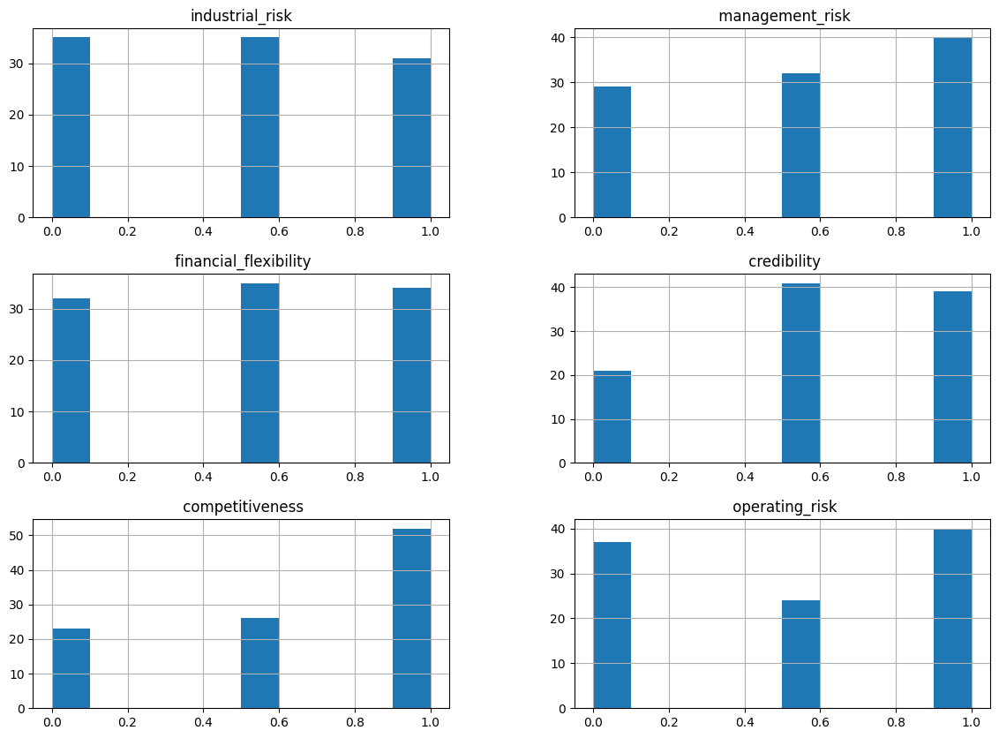

In [28]:
from matplotlib import pyplot
data1=bank1.iloc[0:,:6]
data1.hist(figsize=(14,10))
pyplot.show

### By Looking at this histogram we can say that we have higher risks than credibility and competitiveness

# 2.CountPlot

<AxesSubplot: xlabel=' class', ylabel='count'>

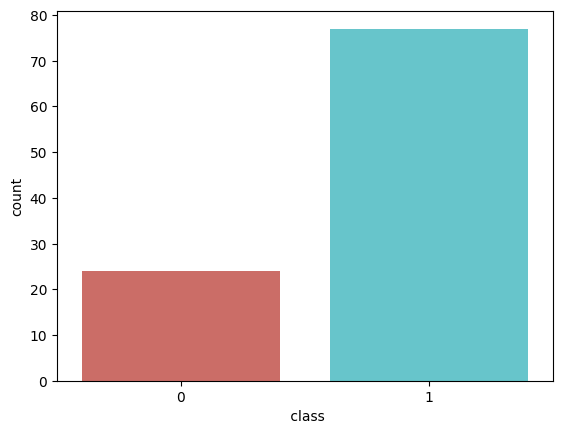

In [31]:
sns.countplot(x = ' class', data = bank1, palette = 'hls')


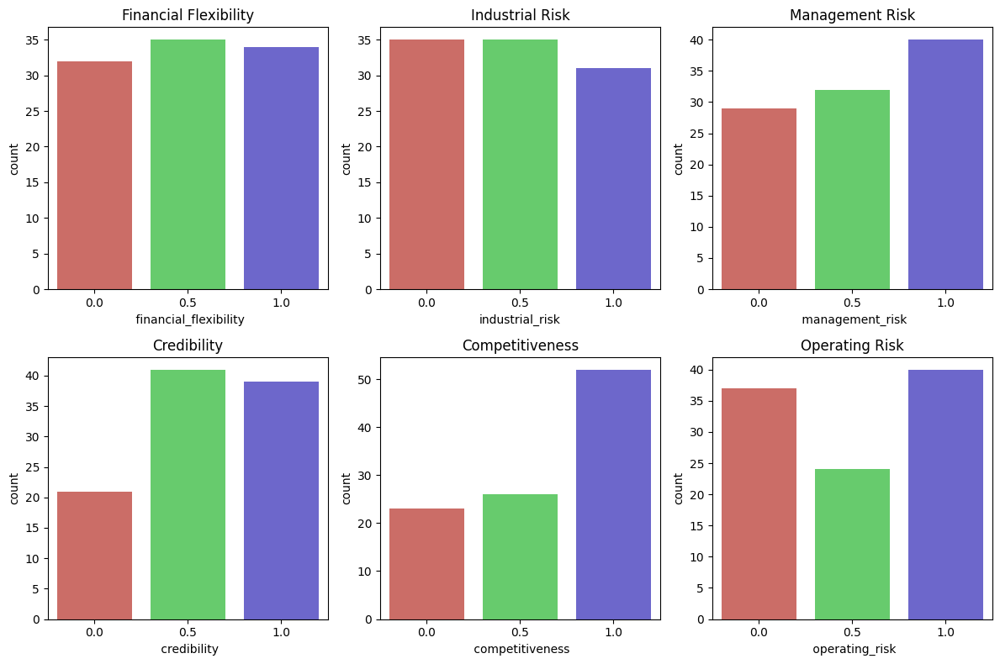

In [32]:
#The countplot is a bar plot that shows the number of occurrences of each category in a categorical variable.

# create a grid of 2 rows and 3 columns
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(12, 8))

# plot each countplot in a different subplot
sns.countplot(x=' financial_flexibility', data=bank1, palette='hls', ax=axes[0, 0])
sns.countplot(x='industrial_risk', data=bank1, palette='hls', ax=axes[0, 1])
sns.countplot(x=' management_risk', data=bank1, palette='hls', ax=axes[0, 2])
sns.countplot(x=' credibility', data=bank1, palette='hls', ax=axes[1, 0])
sns.countplot(x=' competitiveness', data=bank1, palette='hls', ax=axes[1, 1])
sns.countplot(x=' operating_risk', data=bank1, palette='hls', ax=axes[1, 2])

# set titles and labels for the subplots
axes[0, 0].set_title('Financial Flexibility')
axes[0, 1].set_title('Industrial Risk')
axes[0, 2].set_title('Management Risk')
axes[1, 0].set_title('Credibility')
axes[1, 1].set_title('Competitiveness')
axes[1, 2].set_title('Operating Risk')
plt.tight_layout()
plt.show()

By Looking at this histogram we can say that we have higher risks than credibility and competitiveness

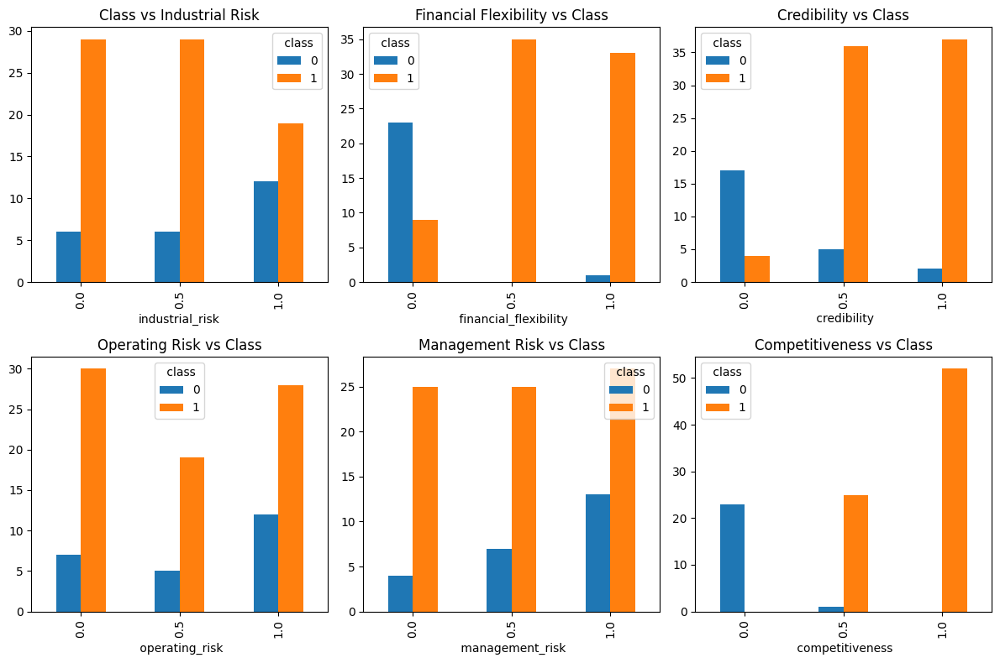

In [42]:
# To create a contingency table (also known as a cross-tabulation table) that shows the frequency distribution of the two variablesand The resulting table shows the number of instances of each combination of values between the two variables.

# create a grid of 2 rows and 3 columns
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(12, 8))

# plot each crosstab plot in a different subplot
pd.crosstab(bank1['industrial_risk'] ,bank1[' class']).plot(kind='bar', ax=axes[0, 0])
pd.crosstab(bank1[' financial_flexibility'],bank1[' class']).plot(kind='bar', ax=axes[0, 1])
pd.crosstab(bank1[' credibility'],bank1[' class']).plot(kind='bar', ax=axes[0, 2])
pd.crosstab(bank1[' operating_risk'], bank1[' class']).plot(kind='bar', ax=axes[1, 0])
pd.crosstab(bank1[' management_risk'], bank1[' class']).plot(kind='bar', ax=axes[1, 1])
pd.crosstab(bank1[' competitiveness'], bank1[' class']).plot(kind='bar', ax=axes[1, 2])

# set titles and labels for the subplots
axes[0, 0].set_title('Class vs Industrial Risk')
axes[0, 1].set_title('Financial Flexibility vs Class')
axes[0, 2].set_title('Credibility vs Class')
axes[1, 0].set_title('Operating Risk vs Class')
axes[1, 1].set_title('Management Risk vs Class')
axes[1, 2].set_title('Competitiveness vs Class')

plt.tight_layout()
plt.show()

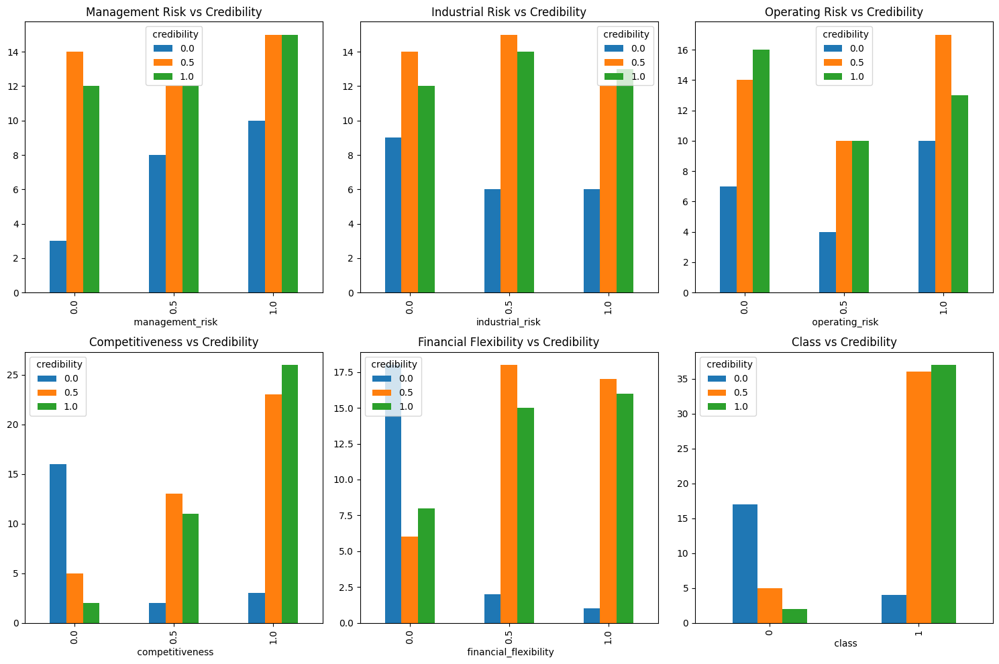

In [38]:
# To visualize the relationship between two categorical variables in a DataFrame and to identify any patterns or trends in the data and to compare the distribution of one variable across different categories of another variable.

# create subplots
fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(15,10))

# plot each crosstab on a separate subplot
pd.crosstab(bank1[' management_risk'], bank1[' credibility']).plot(kind='bar', ax=axs[0,0])
pd.crosstab(bank1['industrial_risk'], bank1[' credibility']).plot(kind='bar', ax=axs[0,1])
pd.crosstab(bank1[' operating_risk'], bank1[' credibility']).plot(kind='bar', ax=axs[0,2])
pd.crosstab(bank1[' competitiveness'], bank1[' credibility']).plot(kind='bar', ax=axs[1,0])
pd.crosstab(bank1[' financial_flexibility'], bank1[' credibility']).plot(kind='bar', ax=axs[1,1])
pd.crosstab(bank1[' class'], bank1[' credibility']).plot(kind='bar', ax=axs[1,2])

# set titles for subplots
axs[0,0].set_title('Management Risk vs Credibility')
axs[0,1].set_title('Industrial Risk vs Credibility')
axs[0,2].set_title('Operating Risk vs Credibility')
axs[1,0].set_title('Competitiveness vs Credibility')
axs[1,1].set_title('Financial Flexibility vs Credibility')
axs[1,2].set_title('Class vs Credibility')

# adjust the layout of subplots
plt.tight_layout()

# display the plot
plt.show()

# 3.Box Plot

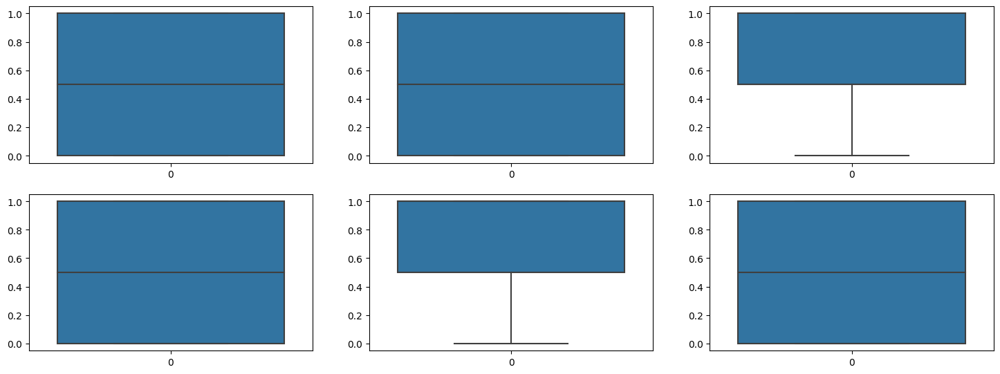

In [43]:
## Finding outliers using box plot

plt.figure(figsize=(18,10))

plt.subplot(3,3,1)
sns.boxplot(bank1['industrial_risk'])

plt.subplot(3,3,2)
sns.boxplot(bank1[' financial_flexibility'])

plt.subplot(3,3,3)
sns.boxplot(bank1[' credibility'])

plt.subplot(3,3,4)
sns.boxplot(bank1[' management_risk'])

plt.subplot(3,3,5)
sns.boxplot(bank1[' competitiveness'])

plt.subplot(3,3,6)
sns.boxplot(bank1[' operating_risk'])


plt.show()


#### Step4: Calculate And Visualize

In [44]:
# Correlation
bank1.corr()

,industrial_risk,management_risk,financial_flexibility,credibility,competitiveness,operating_risk,class,scores,anomaly
industrial_risk,1.000000,0.216055,-0.074670,0.077071,-0.193967,0.142195,-0.200251,-0.073881,-0.128759
management_risk,0.216055,1.000000,-0.152790,-0.096053,-0.121341,0.092411,-0.181312,0.047965,0.013293
financial_flexibility,-0.074670,-0.152790,1.000000,0.402641,0.549276,-0.014874,0.646953,0.246377,-0.121292
credibility,0.077071,-0.096053,0.402641,1.000000,0.517297,-0.098875,0.598013,0.243716,0.023767
competitiveness,-0.193967,-0.121341,0.549276,0.517297,1.000000,-0.025994,0.855806,0.410513,0.158419
operating_risk,0.142195,0.092411,-0.014874,-0.098875,-0.025994,1.000000,-0.114283,0.054742,0.117999
class,-0.200251,-0.181312,0.646953,0.598013,0.855806,-0.114283,1.000000,0.433815,0.179118
scores,-0.073881,0.047965,0.246377,0.243716,0.410513,0.054742,0.433815,1.000000,0.338996
anomaly,-0.128759,0.013293,-0.121292,0.023767,0.158419,0.117999,0.179118,0.338996,1.000000


#### IN this correlation matrix we can see no columns are correlated to each other neither input variables

# Heat map

<AxesSubplot: >

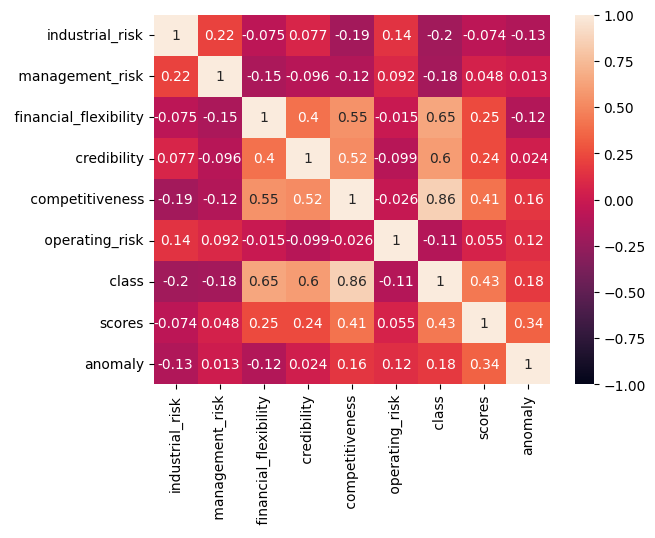

In [45]:
# Correlation PLot

sns.heatmap(bank1.corr(), vmin = -1, vmax = 1, annot = True)

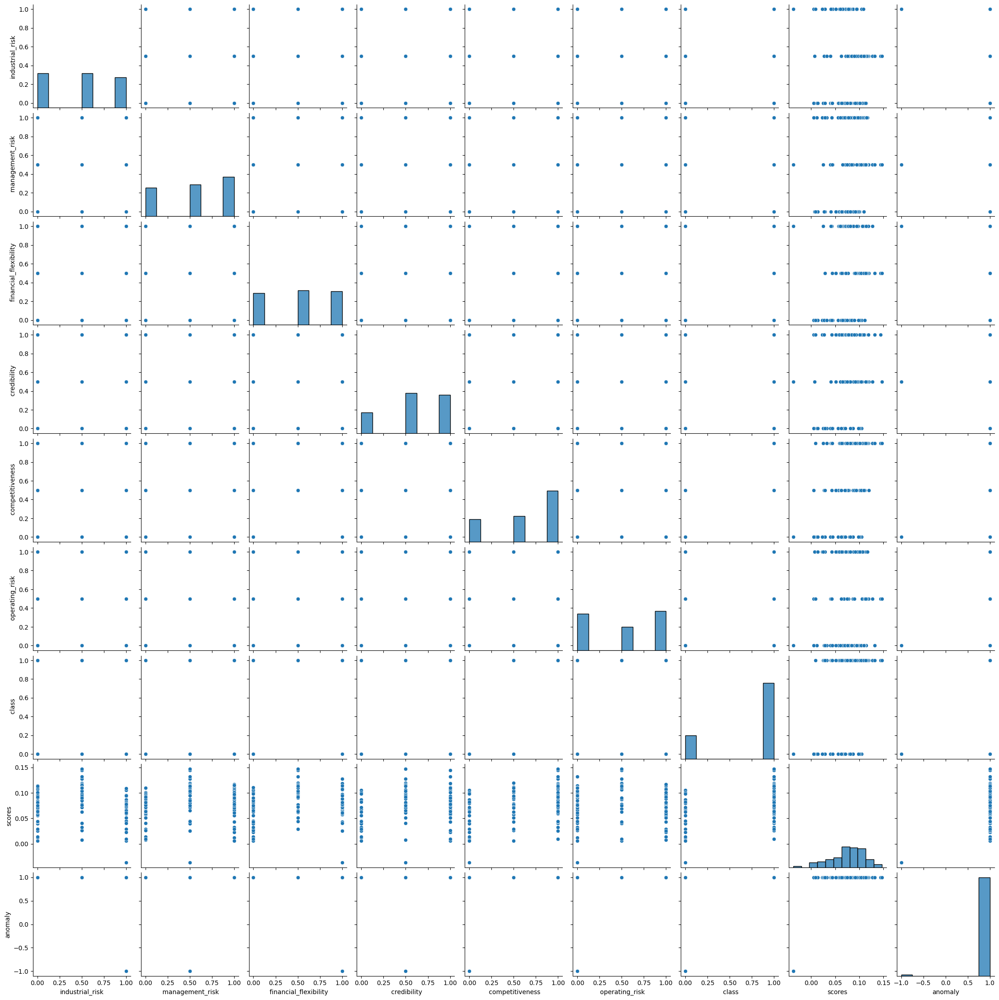

In [46]:
sns.pairplot(bank1)

In [47]:
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE
# Recursive Feature Elimination

X = bank1.iloc[:,0:6]
Y = bank1.iloc[:,-3]


In [48]:
X

,industrial_risk,management_risk,financial_flexibility,credibility,competitiveness,operating_risk
0,0.5,1.0,0.0,0.0,0.0,0.5
1,0.0,1.0,0.0,0.0,0.0,1.0
2,1.0,0.0,0.0,0.0,0.0,1.0
3,0.5,0.0,0.0,0.5,0.0,1.0
4,1.0,1.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...
96,0.0,0.5,0.0,0.5,1.0,0.5
97,0.0,0.5,0.5,0.5,1.0,0.5
98,0.0,0.5,0.5,0.0,1.0,0.0
99,0.5,1.0,0.0,0.0,1.0,0.0


In [49]:
Y

0      0
1      0
2      0
3      0
4      0
      ..
96     1
97     1
98     1
99     1
100    1
Name:  class, Length: 101, dtype: int32

In [50]:
!pip install sweetviz

  Using cached sweetviz-2.1.4-py3-none-any.whl (15.1 MB)
  Using cached importlib_resources-5.12.0-py3-none-any.whl (36 kB)


                                             |                                             | [  0%]   00:00 ->…


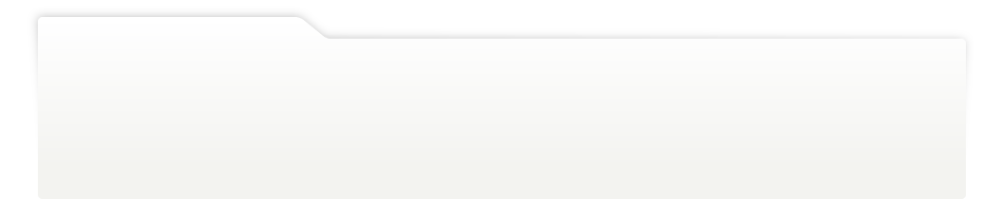
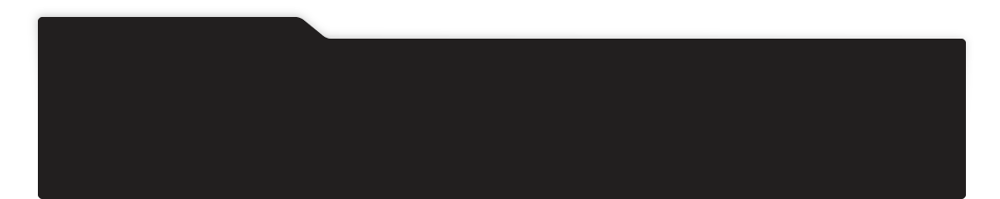
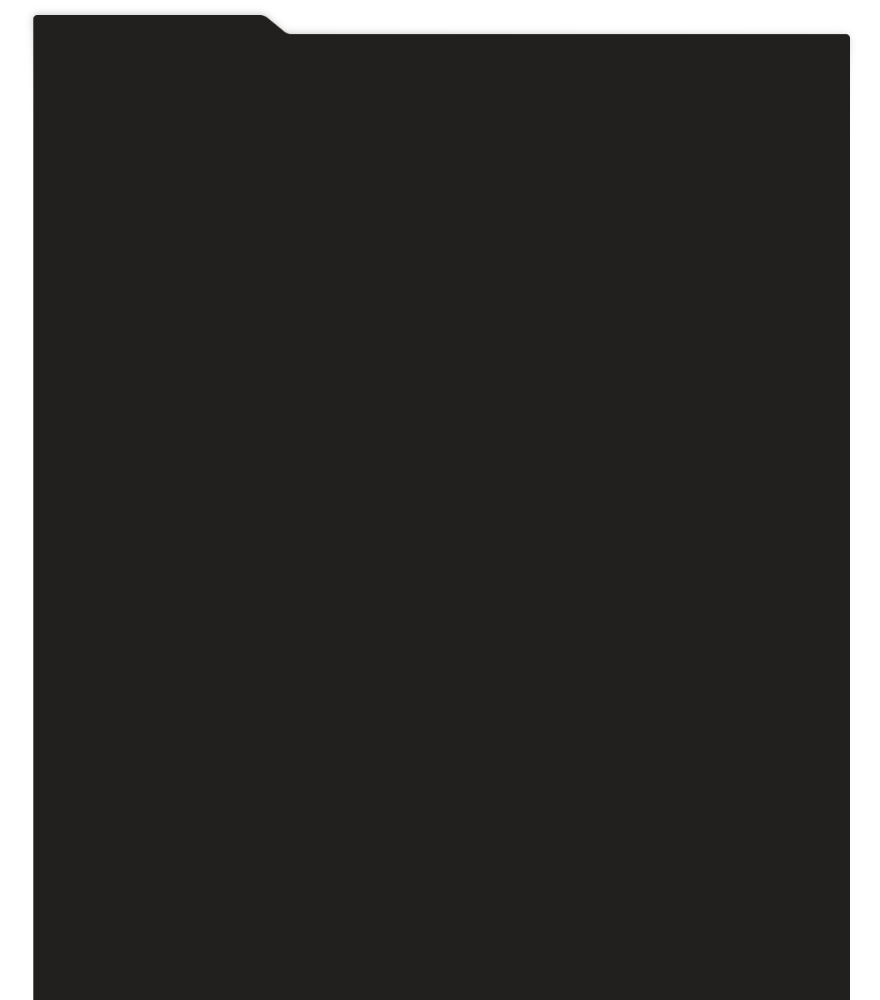
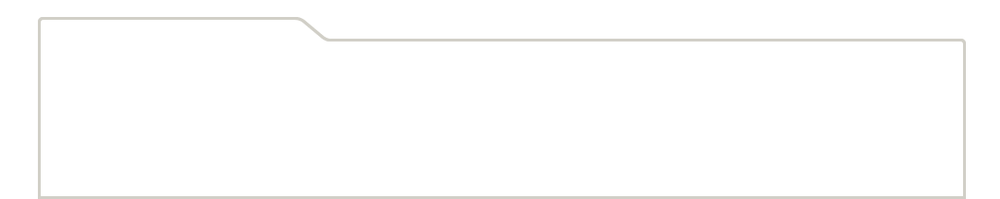
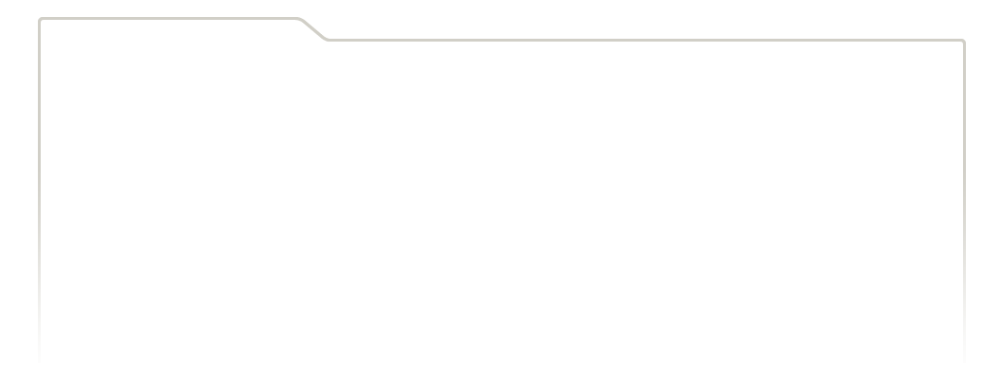
...
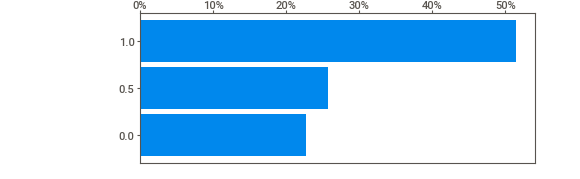
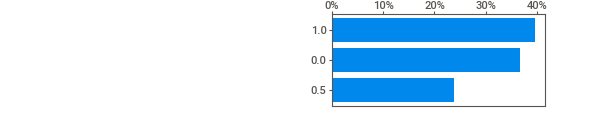
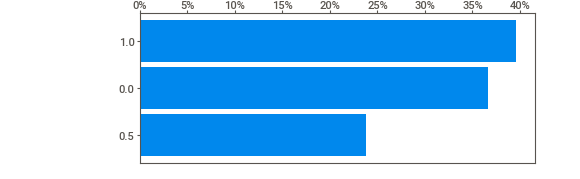
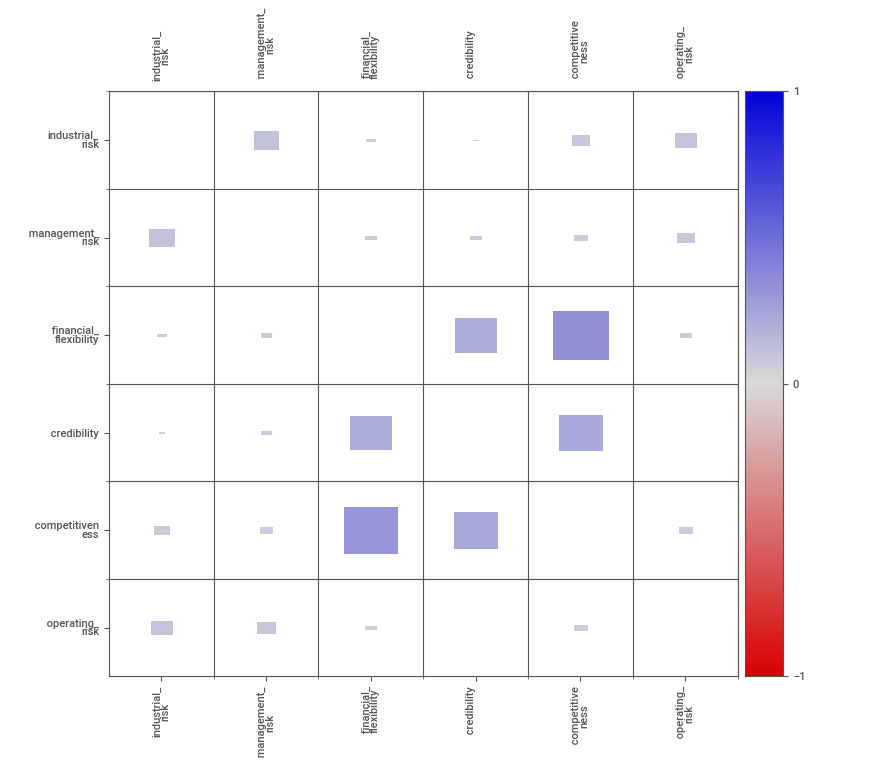
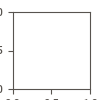

In [51]:
import sweetviz as sv
sweet_report = sv.analyze(data1)
sweet_report.show_notebook(layout='vertical' , w=880, h=700, scale=0.8)

## Train Test Split

### Train Test split Splitting our dataset into train and test using train_test_split(), what we are doing here is taking 80% of data to train our model, and 20% that we will hold back as a validation dataset:

In [52]:
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=1)

# Model Building

In [53]:
from sklearn.ensemble import VotingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import MultinomialNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier,ExtraTreesClassifier,AdaBoostClassifier,BaggingClassifier,GradientBoostingClassifier

In [54]:
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score

In [55]:
from sklearn.metrics import f1_score

In [56]:
models = [DecisionTreeClassifier(),
          RandomForestClassifier(),
          SVC(),
          LogisticRegression(max_iter=1000),
          KNeighborsClassifier(),
          BaggingClassifier(),
          GradientBoostingClassifier(),
          ExtraTreesClassifier(n_estimators=50,random_state=2)]

In [57]:
accuracy1 = []

for model in models:
    cross_val = model
    cross_val.fit(X_train, Y_train)
    cross_val2 = cross_val.score(X_test, Y_test)
    
    accuracy1.append(cross_val2)


In [58]:
models_name = ['DecisionTreeClassifier', 'RandomForestClassifier', 'SVC',
         'LogisticRegression', 'KNeighborsClassifier','BaggingClassifier','GradientBoostingClassifier','ExtraTreesClassifier']

acc = pd.DataFrame({'Model': models_name,'Test accuracy': accuracy1})                            
acc

,Model,Test accuracy
0,DecisionTreeClassifier,0.952381
1,RandomForestClassifier,1.000000
2,SVC,1.000000
3,LogisticRegression,1.000000
4,KNeighborsClassifier,1.000000
5,BaggingClassifier,1.000000
6,GradientBoostingClassifier,0.952381
7,ExtraTreesClassifier,1.000000


In [59]:
import plotly.express as px
fig = px.funnel(acc, x=models_name, y="Test accuracy")
fig.show()

##  Building Decision Tree Classifier using Entropy Criteria

In [60]:
from sklearn.tree import DecisionTreeClassifier
model = DecisionTreeClassifier(criterion = 'entropy',max_depth=3)
model.fit(X_train , Y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=3)

In [61]:
from sklearn import tree

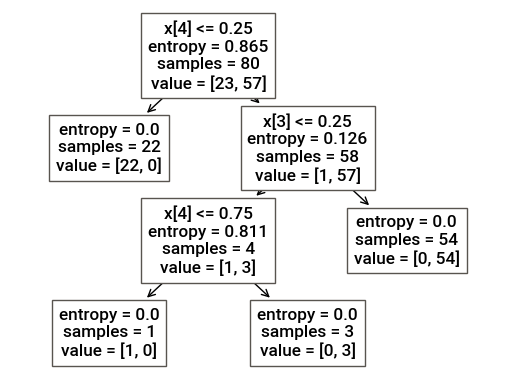

In [62]:
#PLot the decision tree
tree.plot_tree(model);

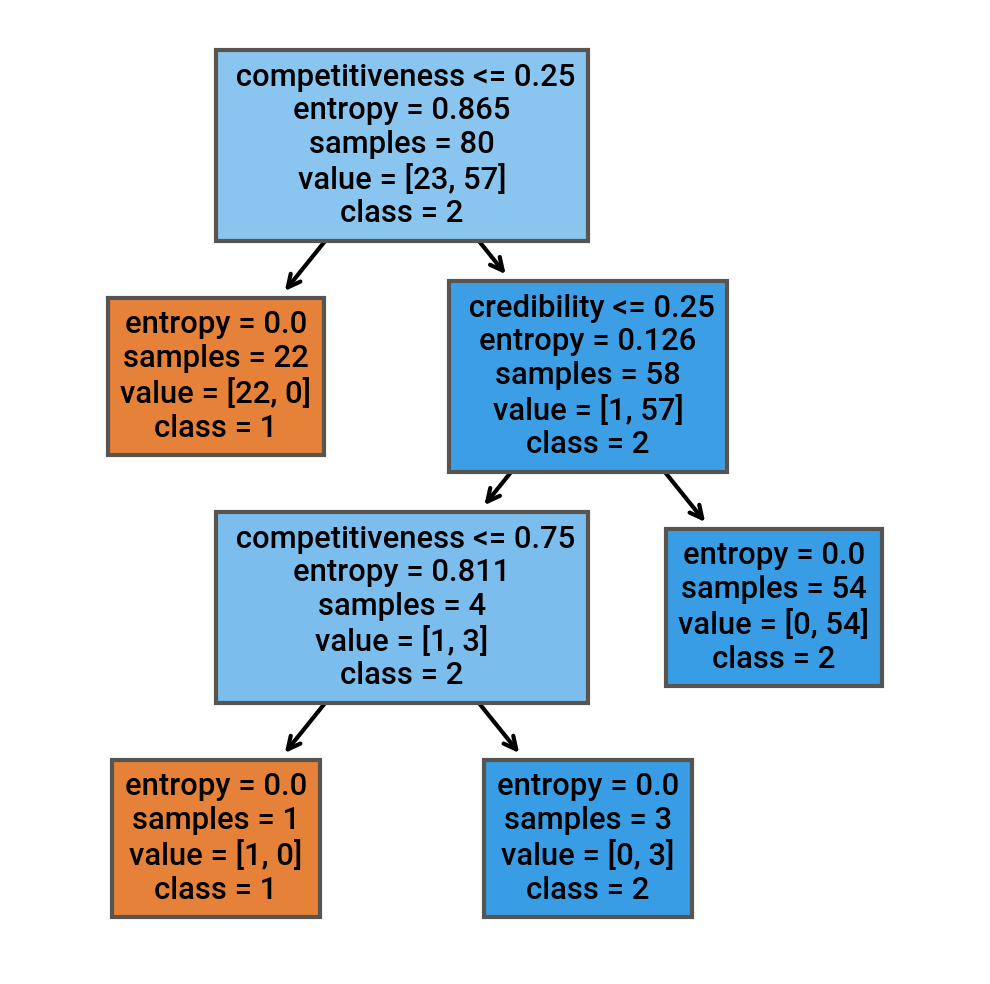

In [63]:
fn=['industrial_risk', ' management_risk', ' financial_flexibility',
       ' credibility', ' competitiveness', ' operating_risk']
cn=['1', '2', '3']
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (4,4), dpi=300)
tree.plot_tree(model,
               feature_names = fn, 
               class_names=cn,
               filled = True);

In [64]:
bank1.columns

Index(['industrial_risk', ' management_risk', ' financial_flexibility',
       ' credibility', ' competitiveness', ' operating_risk', ' class',
       'scores', 'anomaly'],
      dtype='object')

In [65]:
#Predicting on test data
preds = model.predict(X_test) # predicting on test data set 
pd.Series(preds).value_counts() # getting the count of each category

1    19
0     2
dtype: int64

In [66]:
preds

array([1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [67]:
pd.crosstab(Y_test,preds) # getting the 2 way table to understand the correct and wrong

col_0,0,1
class,,
0,1,0
1,1,19


In [68]:
# Accuracy 
np.mean(preds==Y_test)

0.9523809523809523

## # Building Decision Tree Classifier (CART) using Gini Criteria

In [69]:
from sklearn.tree import DecisionTreeClassifier
model_gini = DecisionTreeClassifier(criterion='gini', max_depth=3)

In [70]:
model_gini.fit(X_train, Y_train)

DecisionTreeClassifier(max_depth=3)

In [71]:
#Prediction and computing the accuracy
pred=model.predict(X_test)
np.mean(preds==Y_test)

0.9523809523809523

# PPS Score

In [72]:
data2=bank1.iloc[:,0:7]

In [73]:
!pip install ppscore

In [74]:
#calculate the whole PPS matrix
import ppscore as pps
pps.matrix(data2)

,x,y,ppscore,case,is_valid_score,metric,baseline_score,model_score,model
0,industrial_risk,industrial_risk,1.000000,predict_itself,True,None,0.000000,1.000000,None
1,industrial_risk,management_risk,0.000000,regression,True,mean absolute error,0.341584,0.342595,DecisionTreeRegressor()
2,industrial_risk,financial_flexibility,0.000000,regression,True,mean absolute error,0.326733,0.344501,DecisionTreeRegressor()
3,industrial_risk,credibility,0.000000,regression,True,mean absolute error,0.297030,0.321772,DecisionTreeRegressor()
4,industrial_risk,competitiveness,0.000000,regression,True,mean absolute error,0.356436,0.376724,DecisionTreeRegressor()
5,industrial_risk,operating_risk,0.000000,regression,True,mean absolute error,0.381188,0.395319,DecisionTreeRegressor()
6,industrial_risk,class,0.000000,regression,True,mean absolute error,0.237624,0.352534,DecisionTreeRegressor()
7,management_risk,industrial_risk,0.000000,regression,True,mean absolute error,0.326733,0.353095,DecisionTreeRegressor()
8,management_risk,management_risk,1.000000,predict_itself,True,None,0.000000,1.000000,None
9,management_risk,financial_flexibility,0.000000,regression,True,mean absolute error,0.326733,0.346433,DecisionTreeRegressor()


### as we can see that competitiveness ,credibility and financial flexibility are more important with respect to our target variable class

# Logistic Regression

In [75]:
# building model 
#Fitting Logistic Regression to the training set  
from sklearn.linear_model import LogisticRegression  
classifier= LogisticRegression(random_state=0)  
classifier.fit(X_test , Y_test)

LogisticRegression(random_state=0)

In [76]:
Y_test_pred=classifier.predict(X_test)

In [77]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

#print classification report for model
print(classification_report(Y_test, Y_test_pred))
acc_LR = accuracy_score(Y_test, Y_test_pred)
prec = precision_score(Y_test, Y_test_pred)
recall = recall_score(Y_test, Y_test_pred)
f1 = f1_score(Y_test, Y_test_pred)
print("accuracy_score : ", acc_LR)
print("precision_score : ", prec)
print("recall_score : ", recall)
print("f1_score : ", f1)
cf_matrix=confusion_matrix(Y_test_pred,Y_test)
cf_matrix

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         1
           1       0.95      1.00      0.98        20

    accuracy                           0.95        21
   macro avg       0.48      0.50      0.49        21
weighted avg       0.91      0.95      0.93        21

accuracy_score :  0.9523809523809523
precision_score :  0.9523809523809523
recall_score :  1.0
f1_score :  0.975609756097561


array([[ 0,  0],
       [ 1, 20]], dtype=int64)

In [78]:
# building model 
#Fitting Logistic Regression to the training set 
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.linear_model import LogisticRegression  
classifier= LogisticRegression(random_state=0)  
classifier.fit(X_train, Y_train)
acc_LR = accuracy_score(Y_test, Y_test_pred)
prec = precision_score(Y_test, Y_test_pred)
recall = recall_score(Y_test, Y_test_pred)
f1 = f1_score(Y_test, Y_test_pred)
print("accuracy_score : ", acc_LR)
print("precision_score : ", prec)
print("recall_score : ", recall)
print("f1_score : ", f1)
cf_matrix=confusion_matrix(Y_test_pred,Y_test)
cf_matrix

accuracy_score :  0.9523809523809523
precision_score :  0.9523809523809523
recall_score :  1.0
f1_score :  0.975609756097561


array([[ 0,  0],
       [ 1, 20]], dtype=int64)

In [79]:
Y_test_pred=classifier.predict(X_test)

In [80]:
from sklearn.metrics import classification_report

#print classification report for model
print(classification_report(Y_test, Y_test_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         1
           1       1.00      1.00      1.00        20

    accuracy                           1.00        21
   macro avg       1.00      1.00      1.00        21
weighted avg       1.00      1.00      1.00        21



# SVC

In [81]:
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.model_selection import GridSearchCV

In [82]:
model = SVC()

model.fit(X_train, Y_train)

SVC()

In [83]:
y_pred = model.predict(X_test)
y_pred

array([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [84]:
print(confusion_matrix(Y_test, y_pred))

[[ 1  0]
 [ 0 20]]


In [85]:
print(classification_report(Y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         1
           1       1.00      1.00      1.00        20

    accuracy                           1.00        21
   macro avg       1.00      1.00      1.00        21
weighted avg       1.00      1.00      1.00        21



In [86]:
param_grid = {'C' : [1, 5, 7, 15], 'gamma' : [1, 0.1, 0.01, 0.001, 0.0001], 'kernel' : ['rbf']}

In [87]:
grid = GridSearchCV(SVC(), param_grid, refit = True, verbose = 3,  cv = 2)

In [88]:
grid.fit(X_train, Y_train)

Fitting 2 folds for each of 20 candidates, totalling 40 fits
[CV 1/2] END ..........C=1, gamma=1, kernel=rbf;, score=0.975 total time=   0.0s
[CV 2/2] END ..........C=1, gamma=1, kernel=rbf;, score=0.975 total time=   0.0s
[CV 1/2] END ........C=1, gamma=0.1, kernel=rbf;, score=0.975 total time=   0.0s
[CV 2/2] END ........C=1, gamma=0.1, kernel=rbf;, score=0.975 total time=   0.0s
[CV 1/2] END .......C=1, gamma=0.01, kernel=rbf;, score=0.725 total time=   0.0s
[CV 2/2] END .......C=1, gamma=0.01, kernel=rbf;, score=0.700 total time=   0.0s
[CV 1/2] END ......C=1, gamma=0.001, kernel=rbf;, score=0.725 total time=   0.0s
[CV 2/2] END ......C=1, gamma=0.001, kernel=rbf;, score=0.700 total time=   0.0s
[CV 1/2] END .....C=1, gamma=0.0001, kernel=rbf;, score=0.725 total time=   0.0s
[CV 2/2] END .....C=1, gamma=0.0001, kernel=rbf;, score=0.700 total time=   0.0s
[CV 1/2] END ..........C=5, gamma=1, kernel=rbf;, score=0.950 total time=   0.0s
[CV 2/2] END ..........C=5, gamma=1, kernel=rbf;

GridSearchCV(cv=2, estimator=SVC(),
             param_grid={'C': [1, 5, 7, 15],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
                         'kernel': ['rbf']},
             verbose=3)

In [89]:
grid.best_params_

{'C': 1, 'gamma': 1, 'kernel': 'rbf'}

In [90]:
grid_pred = grid.predict(X_test)

In [91]:
grid_pred

array([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [92]:
print(confusion_matrix(Y_test, grid_pred))

[[ 1  0]
 [ 0 20]]


In [93]:
print(classification_report(Y_test, grid_pred))


              precision    recall  f1-score   support

           0       1.00      1.00      1.00         1
           1       1.00      1.00      1.00        20

    accuracy                           1.00        21
   macro avg       1.00      1.00      1.00        21
weighted avg       1.00      1.00      1.00        21



In [94]:
acc_svm =accuracy_score(Y_test,grid_pred)

In [95]:
acc_svm

1.0